In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
from glob import iglob
import scrublet as scr
import anndata
import scanpy.external as sce
import scvelo as scv
#import scrublet as scr # requires 'pip install scrublet'
import os
import sklearn
import bbknn
from sklearn.linear_model import LogisticRegression
import matplotlib as mpl
import scipy
import matplotlib.pyplot as plt
import pickle

np.random.seed(0)
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=100,dpi_save=800)  # low dpi (dots per inch) yields small inline figures

-----
anndata     0.8.0
scanpy      1.9.1
-----
OpenSSL                                     21.0.0
PIL                                         9.0.1
aa8f2297d25b4dc6fd3d98411eb3ba53823c4f42    NA
absl                                        NA
annoy                                       NA
asciitree                                   NA
asttokens                                   NA
astunparse                                  1.6.3
backcall                                    0.2.0
bbknn                                       NA
bcrypt                                      3.2.0
beta_ufunc                                  NA
binom_ufunc                                 NA
boto3                                       1.21.32
botocore                                    1.24.32
bottleneck                                  1.3.4
brotli                                      NA
cairo                                       1.21.0
certifi                                     2021.10.08
cffi              

In [2]:
adata = sc.read_h5ad('./01.single data/scRNA_qc.h5ad')

In [3]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

normalizing counts per cell
    finished (0:00:00)


extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
Highly variable genes: 2987


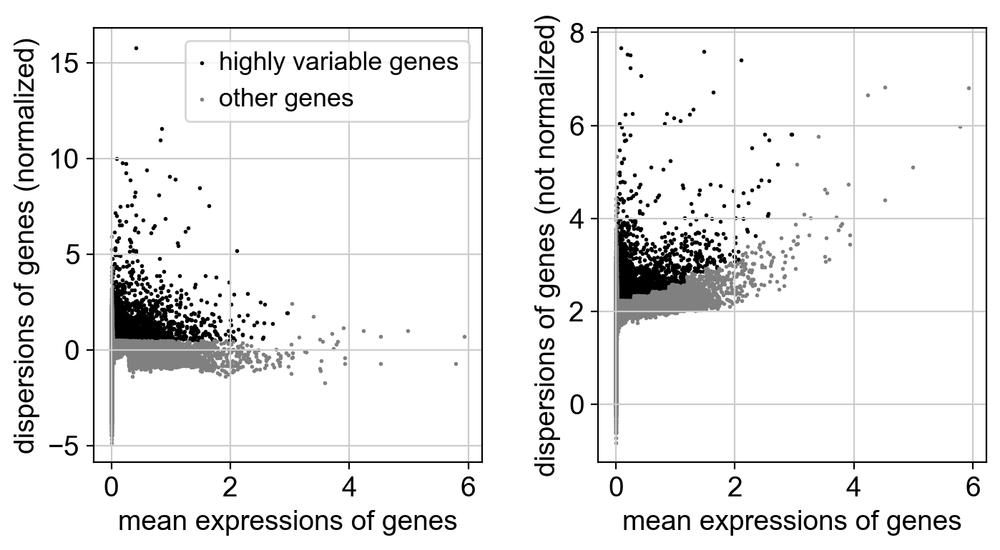

In [4]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
print("Highly variable genes: %d"%sum(adata.var.highly_variable))
sc.pl.highly_variable_genes(adata)

In [5]:
sc.pp.regress_out(adata, ['n_counts', 'pct_counts_mt'])
sc.pp.scale(adata, max_value=10)

regressing out ['n_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:22:29)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:11)


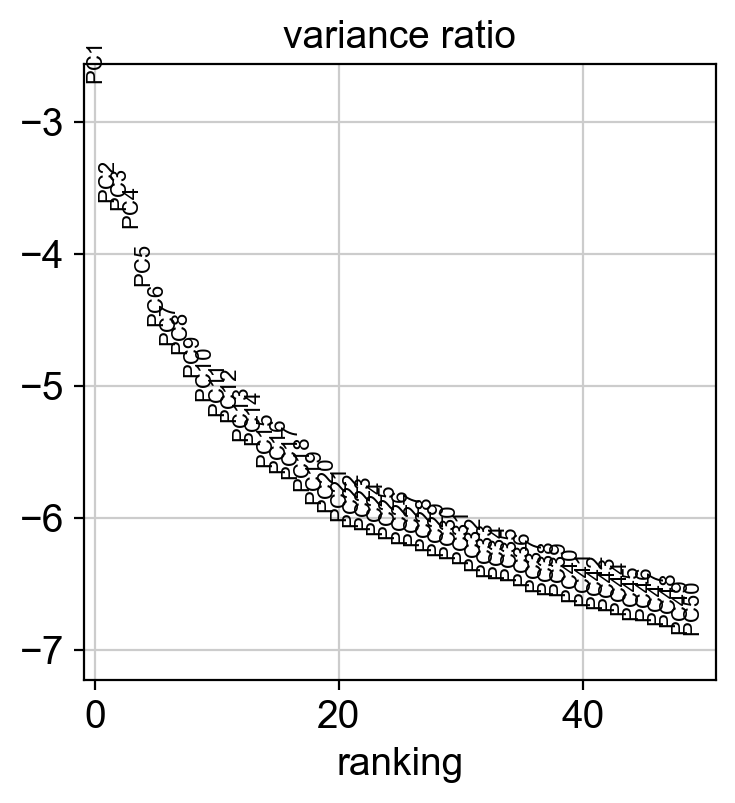

<AxesSubplot:>

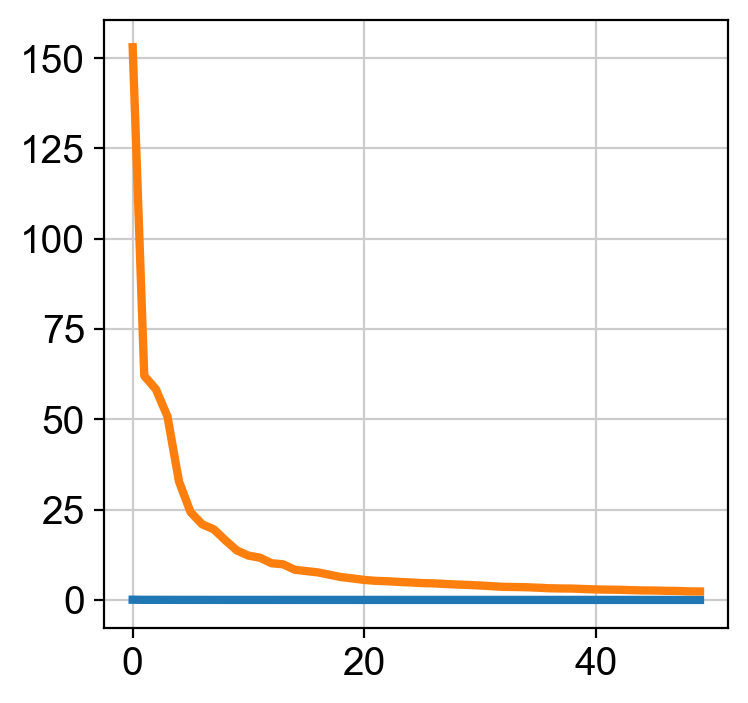

In [6]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata, log=True,n_pcs = 50)
sns.lineplot(data = adata.uns['pca']['variance_ratio'],palette= 'tab10',linewidth = 3)
adata.uns['pca']['variance']
sns.lineplot(data =adata.uns['pca']['variance'],palette='tab10',linewidth = 3)

In [7]:
%%time
# trying out harmony here
# Check PCA again - needed for harmony - and extract PCA matrix and batch array
n_pcs = 30
pca = adata.obsm['X_pca'][:, 0:n_pcs]
batch = adata.obs['ID']

CPU times: total: 0 ns
Wall time: 0 ns


In [8]:
# Batch-correct the PCA using HARMONY method
%load_ext rpy2.ipython

In [9]:
%%time
%%R -i pca -i batch -o hem

library(harmony)
library(magrittr)

hem <- HarmonyMatrix(pca, batch, theta=1, do_pca=FALSE)
hem = data.frame(hem)

Exception ignored from cffi callback <function _consolewrite_ex at 0x000001FB01BE33A0>:
Traceback (most recent call last):
  File "D:\conda\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "D:\conda\lib\site-packages\rpy2\rinterface_lib\conversion.py", line 138, in _cchar_to_str_with_maxlen
    s = ffi.string(c, maxlen).decode(encoding)
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xd4 in position 0: invalid continuation byte
R[write to console]: Harmony 1/10

R[write to console]: 0%   10   20   30   40   50   60   70   80   90   100%

R[write to console]: [----|----|----|----|----|----|----|----|----|----|

R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to co

CPU times: total: 4min 51s
Wall time: 4min 51s


In [10]:
# Add harmony values to the anndata object
adata.obsm['X_pca'] = hem.values

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:43)
neighbors的数值为：10


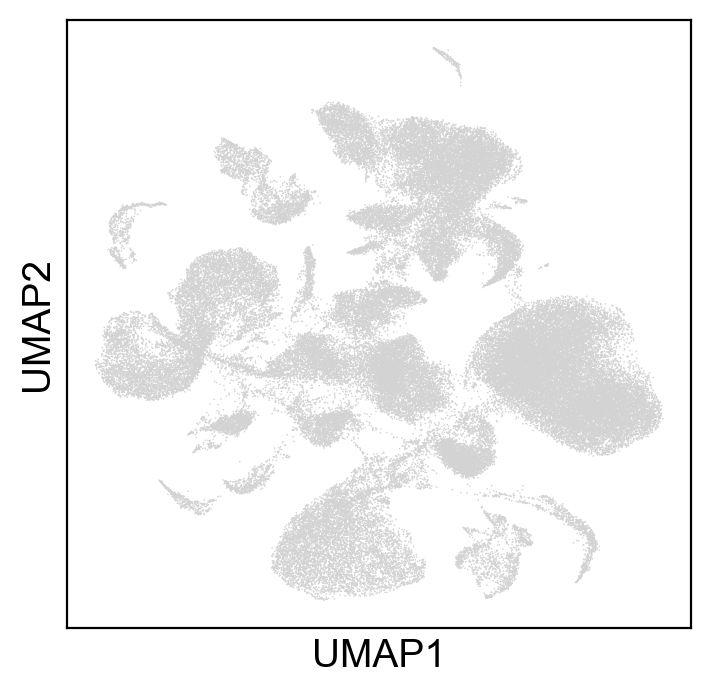

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:43)
neighbors的数值为：15


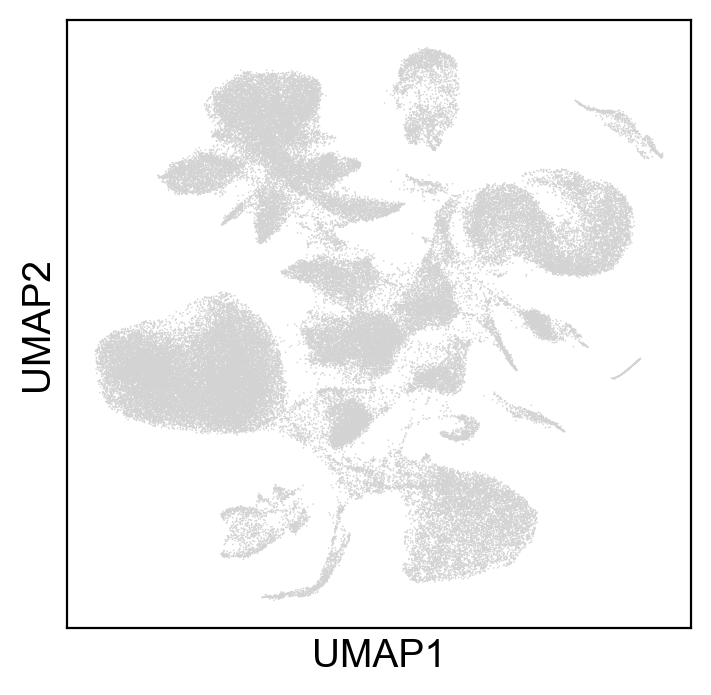

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:47)
neighbors的数值为：20


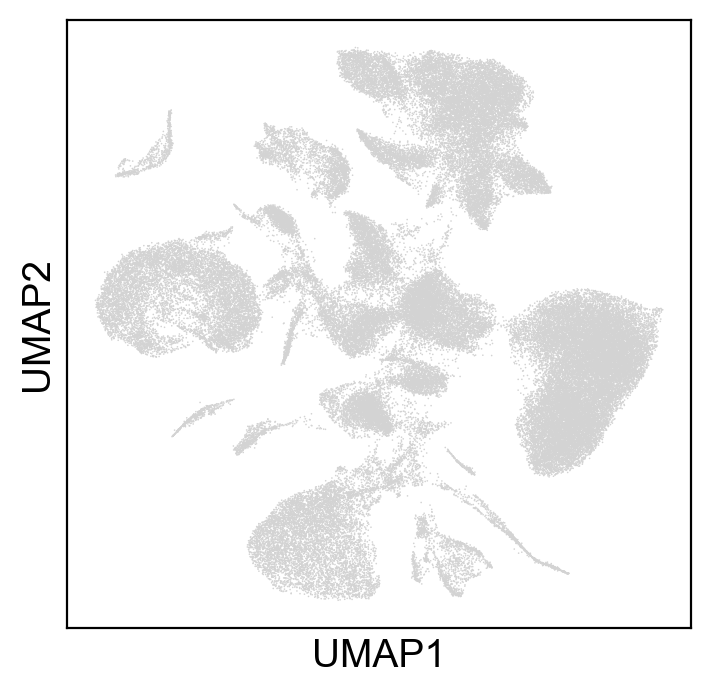

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:51)
neighbors的数值为：25


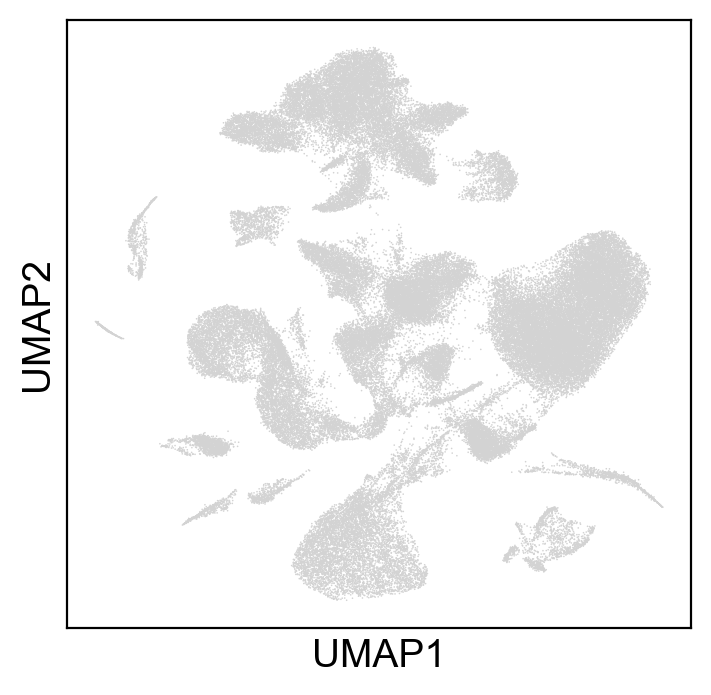

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:05)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:55)
neighbors的数值为：30


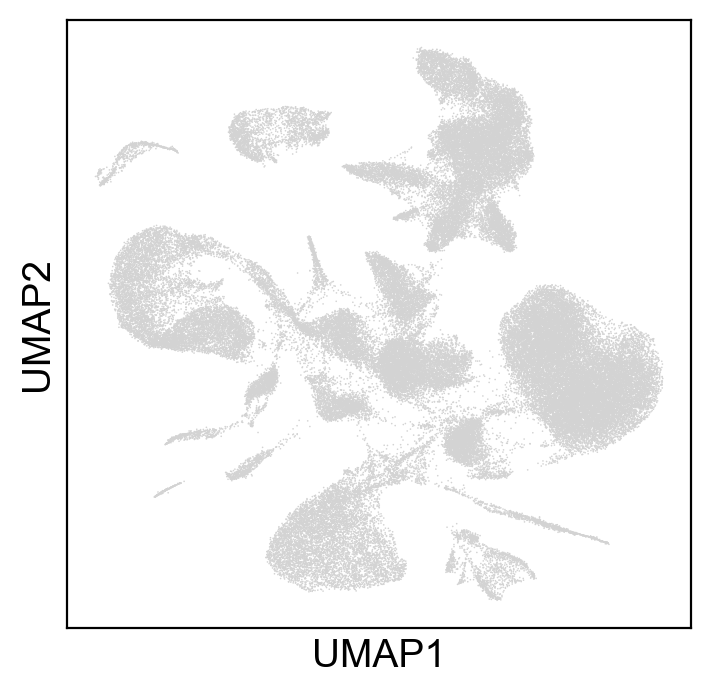

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:57)
neighbors的数值为：35


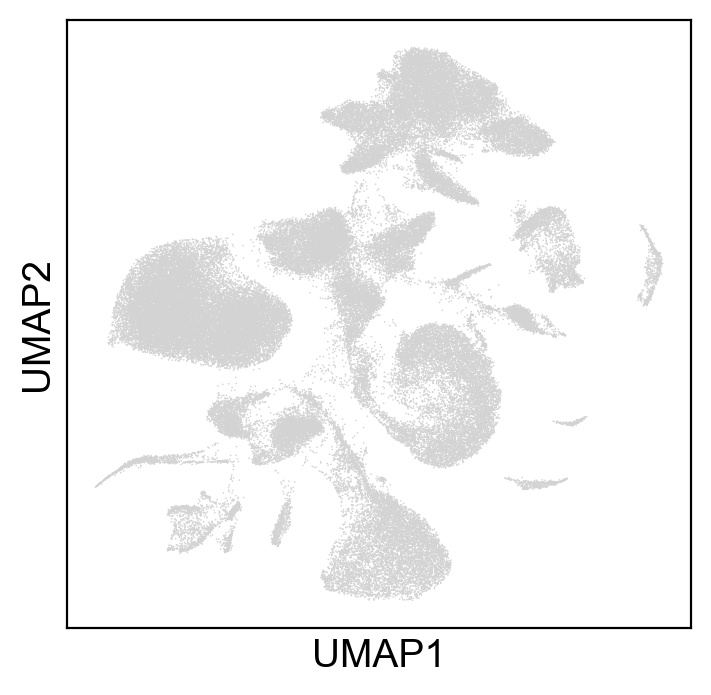

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:00)
neighbors的数值为：40


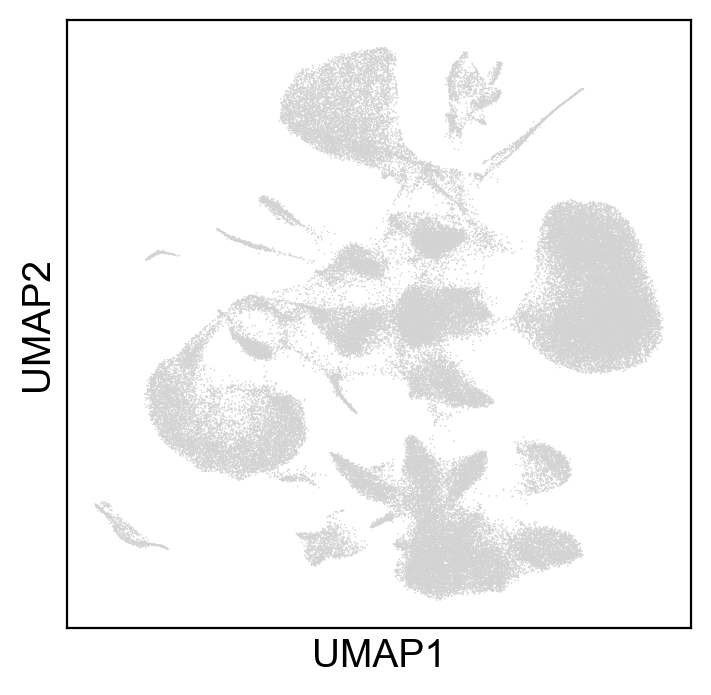

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:02)
neighbors的数值为：45


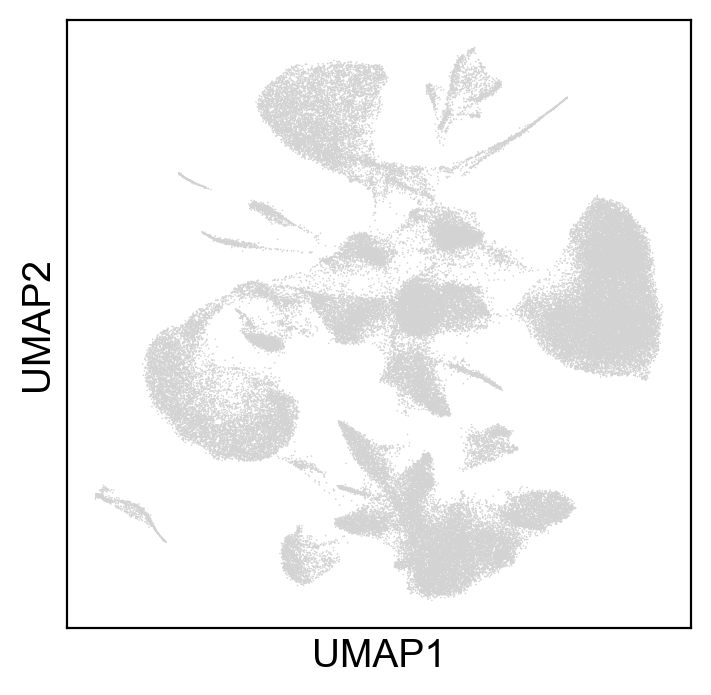

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:11)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:04)
neighbors的数值为：50


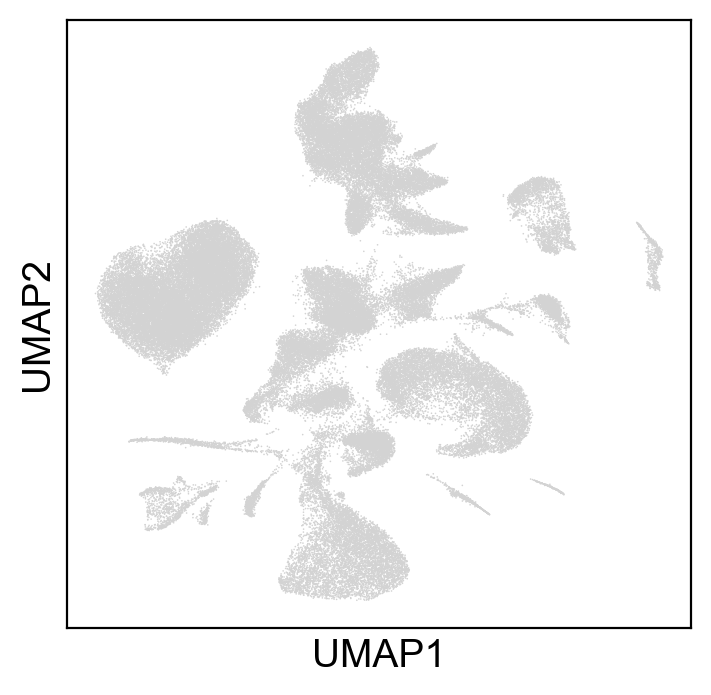

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:07)
neighbors的数值为：55


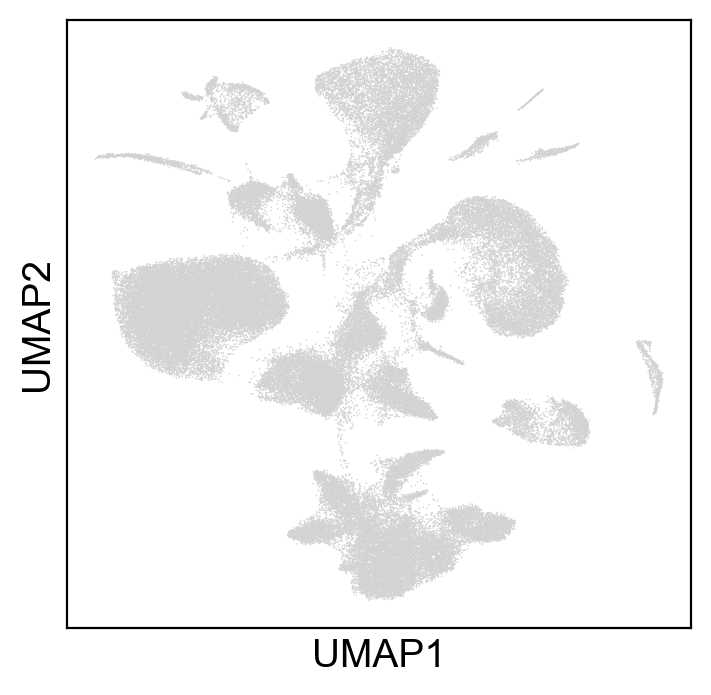

In [16]:
for i in range(10,60,5):
    sc.pp.neighbors(adata,n_pcs=30, n_neighbors= i)
    sc.tl.umap(adata)
    print(f'neighbors的数值为：{i}')
    sc.pl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:06)


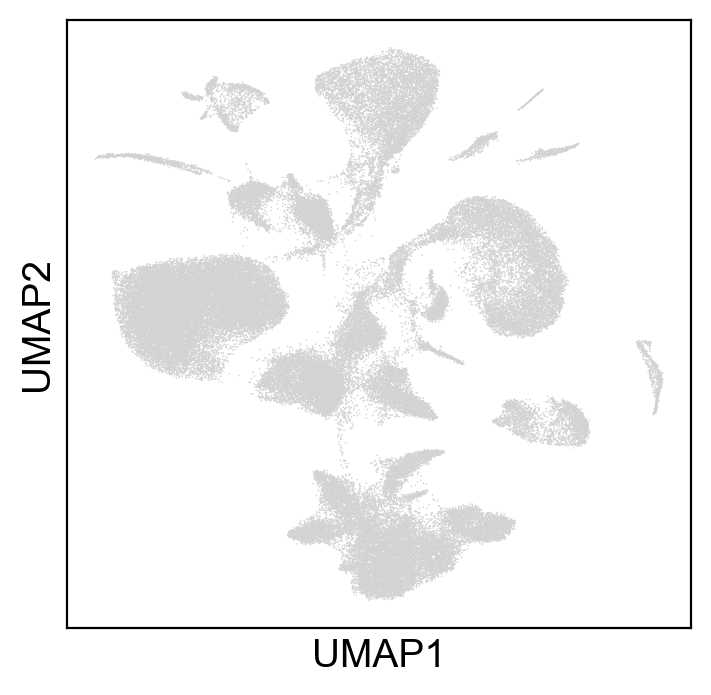

In [15]:
sc.pp.neighbors(adata,n_pcs=30, n_neighbors= 55)
sc.tl.umap(adata)
sc.pl.umap(adata)

In [17]:
adata1 = sc.read_h5ad('./01.single data/scRNA_celltype.h5ad')

In [23]:
umap = adata1.obsm['X_umap']

In [24]:
adata.obsm['X_umap'] = umap

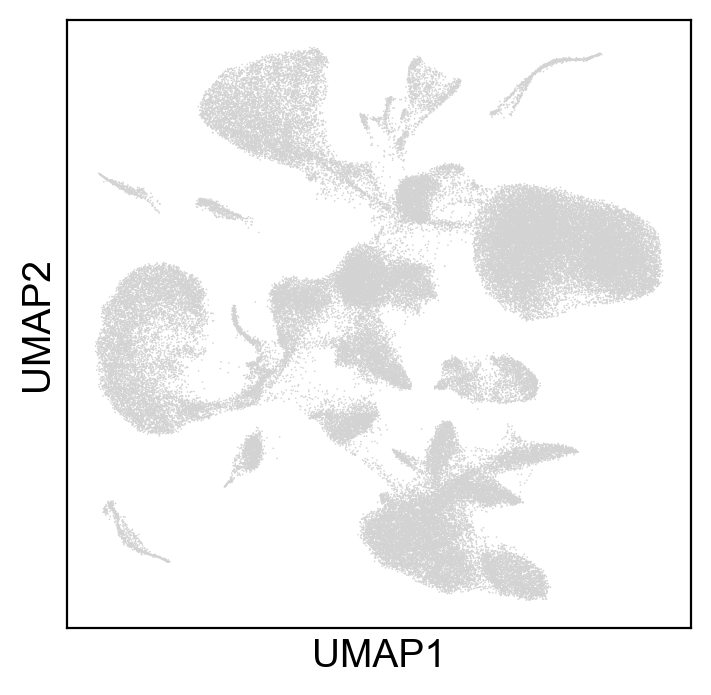

In [25]:
sc.pl.umap(adata)

In [26]:
for i in range(1,16):
    sc.tl.leiden(adata,resolution=round(i*0.1,1),key_added=f'cluster_{round(i*0.1,1)}')

running Leiden clustering
    finished: found 13 clusters and added
    'cluster_0.1', the cluster labels (adata.obs, categorical) (0:02:05)
running Leiden clustering
    finished: found 17 clusters and added
    'cluster_0.2', the cluster labels (adata.obs, categorical) (0:01:45)
running Leiden clustering
    finished: found 21 clusters and added
    'cluster_0.3', the cluster labels (adata.obs, categorical) (0:04:08)
running Leiden clustering
    finished: found 22 clusters and added
    'cluster_0.4', the cluster labels (adata.obs, categorical) (0:03:00)
running Leiden clustering
    finished: found 22 clusters and added
    'cluster_0.5', the cluster labels (adata.obs, categorical) (0:03:35)
running Leiden clustering
    finished: found 24 clusters and added
    'cluster_0.6', the cluster labels (adata.obs, categorical) (0:05:13)
running Leiden clustering
    finished: found 25 clusters and added
    'cluster_0.7', the cluster labels (adata.obs, categorical) (0:03:48)
running Leide

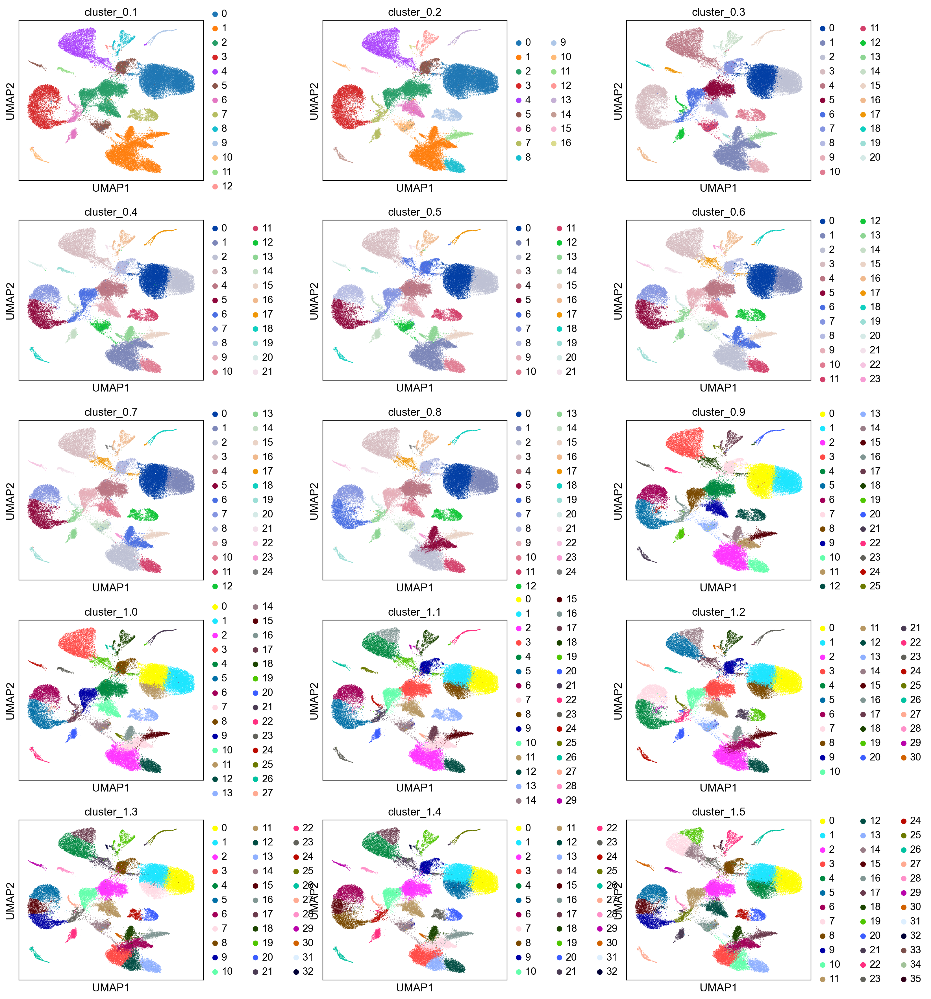

In [27]:
sc.pl.umap(adata,color = [f'cluster_{round(i*0.1,1)}' for i in range(1,16)],ncols = 3,wspace=0.5)

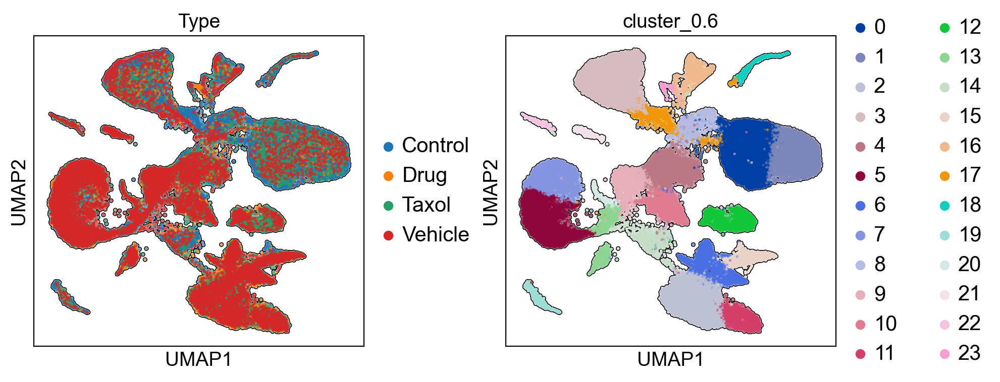

In [28]:
sc.pl.umap(adata, color=['Type','cluster_0.6'],add_outline=True, legend_loc='right margin',size=15,
               legend_fontsize=15, legend_fontoutline= 1,frameon= True,wspace=0.3)

In [29]:
adata.obs['Type'].value_counts()

Control    45618
Vehicle    16099
Drug       13528
Taxol      12831
Name: Type, dtype: int64

In [21]:
adata.obs['Type'].value_counts()

Control    45618
Vehicle    16099
Drug       13528
Taxol      12831
Name: Type, dtype: int64

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:12:11)


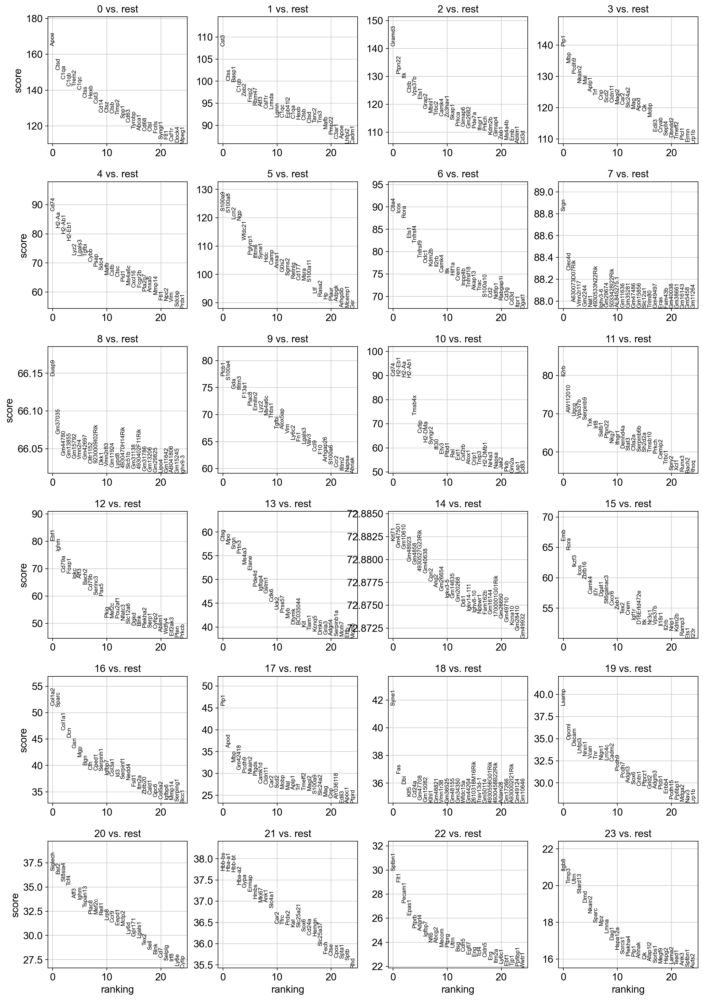

In [30]:
sc.tl.rank_genes_groups(adata,'cluster_0.6',method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [31]:
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(35)

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,Apoe,Cst3,Gramd3,Plp1,Cd74,S100a9,Ctla4,Srgn,Dusp9,Plcb1,...,Krt71,Emb,Col1a2,Plp1,Syne1,Lsamp,Siglech,Hbb-bs,Sptbn1,Itgb8
1,Ctsd,Ctss,Ptpn22,Mbp,H2-Aa,S100a8,Icos,Clec4d,Gm37035,S100a4,...,Gm47501,Rora,Sparc,Apod,Fas,Opcml,Bst2,Hba-a1,Flt1,Timp3
2,C1qa,Basp1,Itk,Pcdh9,H2-Ab1,Lcn2,Rora,A630073D07Rik,Gm44780,Gda,...,Gm10610,Ikzf3,Col1a1,Mbp,Dbi,Dscam,St8sia4,Hbb-bt,Pecam1,Utrn
3,C1qb,C1qb,Cblb,Nkain2,H2-Eb1,Ngp,Ets1,Vmn2r117,Gm13855,Ifitm3,...,Gm48923,Icos,Dcn,Gm42418,Klf5,Lhfpl3,Tcf4,Hba-a2,Epas1,Stard13
4,Trem2,Zeb2,Vps37b,Mal,Lyz2,Wfdc21,Tnfrsf4,Gm2244,Gm15792,F13a1,...,Gm4858,Zbtb16,Gsn,Pcdh9,Cd24a,Nrxn1,Aff3,Gypa,Ptprb,Dmd
5,C1qc,Fnip2,Ets1,Aplp1,Lgals3,Pglyrp1,Tnfrsf9,Nat1,Vmn2r4,Plac8,...,4930527G23Rik,Camk4,Mgp,Nkain2,Gm47708,Vcan,Ighm,Ermap,Adgrl4,Nkain2
6,Ctss,Rbm47,Grap2,Trf,Tgfbi,Ifitm6,Odc1,4930533N22Rik,Gm42697,Emilin2,...,Gm40638,Il7r,Bgn,Ptgds,Gm15082,Tnr,Tspan13,Hmbs,Igfbp7,Sparc
7,Hexb,Atf3,Mbnl1,Cnp,Cybb,Syne1,Kdm2b,Ighv3-6,Olfr1152,Lyz2,...,Cpn2,Dgat1,Cfh,Camk1d,Klhl1,Nlgn1,Plac8,Mki67,Nfib,Mpz
8,Cst3,Csf1r,Trbc2,Scd2,Psap,Hdc,Il2rb,Gm29674,9230009I02Rik,Ms4a6c,...,Ang2,St6galnac3,Cped1,Cldn11,Gm48821,Lrrc4c,Mef2c,Ank1,Abcg2,Lmna
9,Cd14,Lrmda,Camk4,Cldn11,Sdc4,Camp,Camk4,5033428I22Rik,Dkk1,Thbs1,...,Gm26654,Cxcr6,Serpinh1,Car2,Vmn1r38,Cadm2,Rell1,Slc4a1,Mecom,Dag1


In [32]:

result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
res = pd.DataFrame(    {group + '_' + key: result[key][group]    for group in groups for key in ['names', 'pvals','logfoldchanges','pvals_adj','scores']})

In [33]:
res.to_csv("diff_cluster.csv")

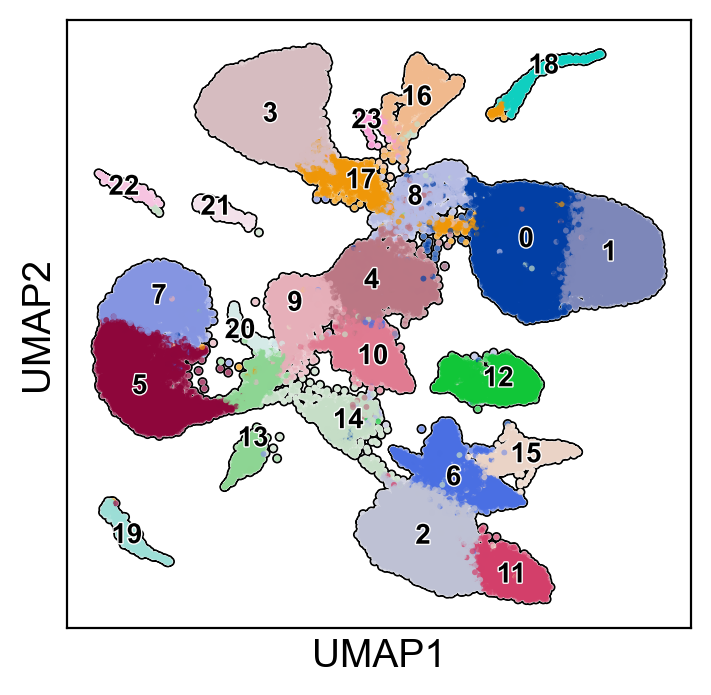

In [36]:
sc.pl.umap(adata, color=['cluster_0.6'],add_outline=True, legend_loc='on data',size=18,title='',
               legend_fontsize=10, legend_fontoutline= 1,frameon= True)

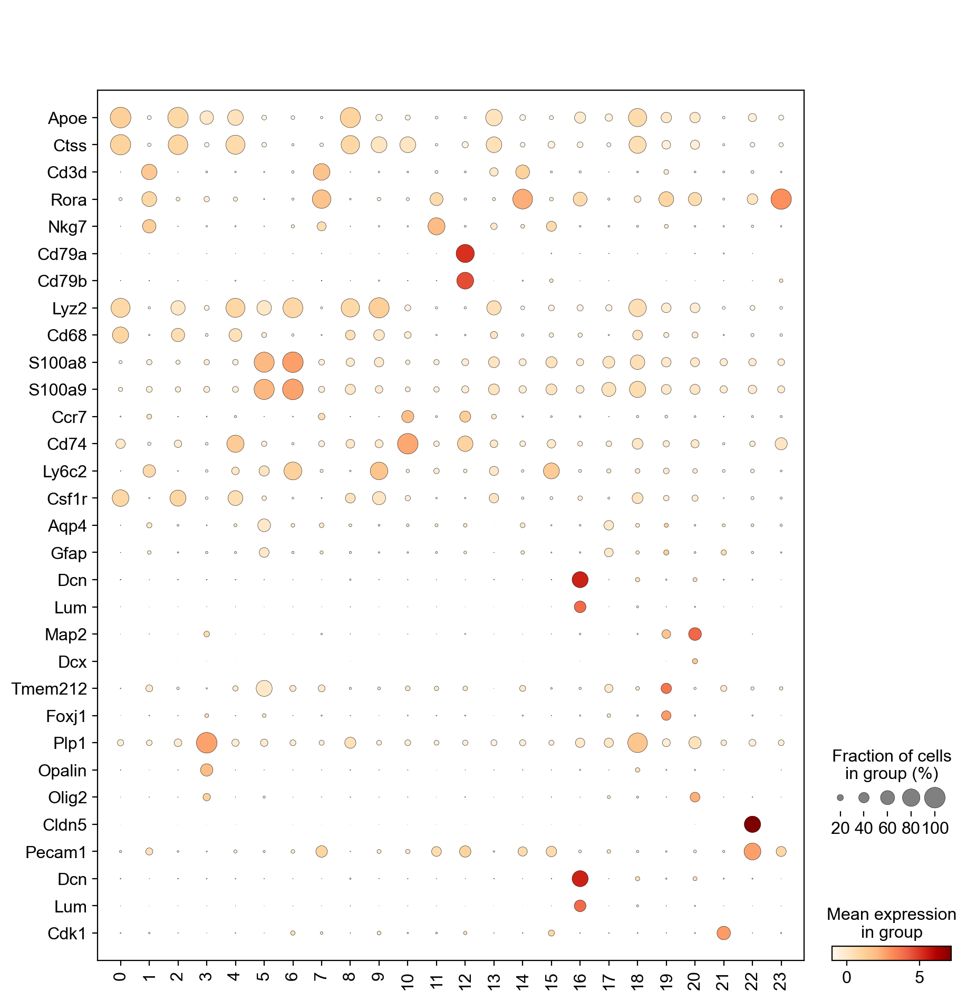

In [281]:
markers = ["Apoe","Ctss",#Microglial
           "Cd3d",#Lymphocyte
           "Rora",#Th17
           "Nkg7",#NK
           "Cd79a","Cd79b",#B
           "Lyz2","Cd68",#Macrophage
           "S100a8","S100a9",#Neutrophil
           'Ccr7',"Cd74",#Dendritic cell
           "Ly6c2","Csf1r",#Monocyte
           "Aqp4","Gfap",#Astrocyte
           "Dcn","Lum",#Fibroblast
           "Map2","Dcx",#Neuron
           "Tmem212","Foxj1",#Ependymal cell
           "Plp1","Opalin",#Oligodendrocyte
           "Olig2",#Oligodendrocyte precursor cell少突胶质前体细胞
           'Cldn5',"Pecam1",#endothelial cell
           "Dcn","Lum",#Fibroblast
           "Cdk1","Mki67",#Dividing cell
          ]
sc.pl.dotplot(adata,markers,'cluster_0.6',cmap='OrRd',swap_axes=True)

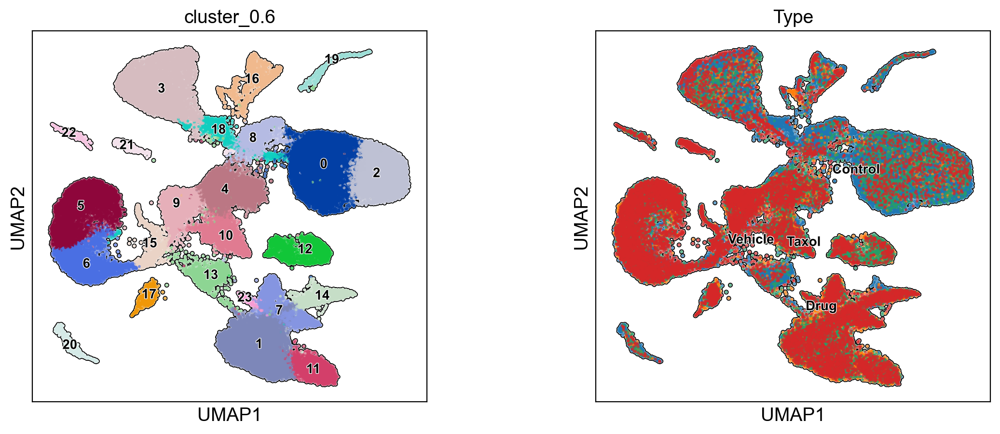

In [267]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(5,5))
sc.pl.umap(adata, color=['cluster_0.6','Type'],add_outline=True, legend_loc='on data',size=18,
               legend_fontsize=10, legend_fontoutline= 1,frameon= True,wspace=0.3)

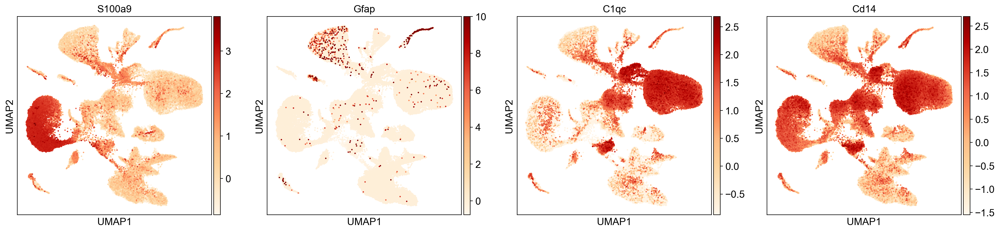

In [279]:
sc.pl.umap(adata,color=["S100a9","Gfap","C1qc","Cd14"],ncols=4,cmap='OrRd',size=15,legend_fontsize=12)

In [358]:
def annot_prelim(cluster):
    if cluster in ["0","2","8"]:
         return('Microglial')
    elif cluster in ['1','7','14']:
        return('Lymphocyte')
    elif cluster in ['3']:
        return('OPC')
    elif cluster in ['4','9']:
        return('Macrophages')
    elif cluster in ['5','6','15']:
        return('Neutrophil')
    elif cluster =='10':
        return('Dendritic cell')
    elif cluster =='11':
        return('NK cell')
    elif cluster =='12':
        return('B cell')
    elif cluster =='13':
        return('Monocyte')
    elif cluster =='16':
        return('Fibroblast')
    elif cluster =='17':
        return('Astrocyte')
    elif cluster =='18':
        return('ODC')
    elif cluster =='19':
        return('Ependymal')
    elif cluster =='20':
        return('Neuron')
    elif cluster =='21':
        return('Dividing cell')
    elif cluster =='22':
        return('Endothelial')
    else:
        return('Th17')

In [359]:
adata.obs['Celltype'] = adata.obs['cluster_0.6'].map(annot_prelim)

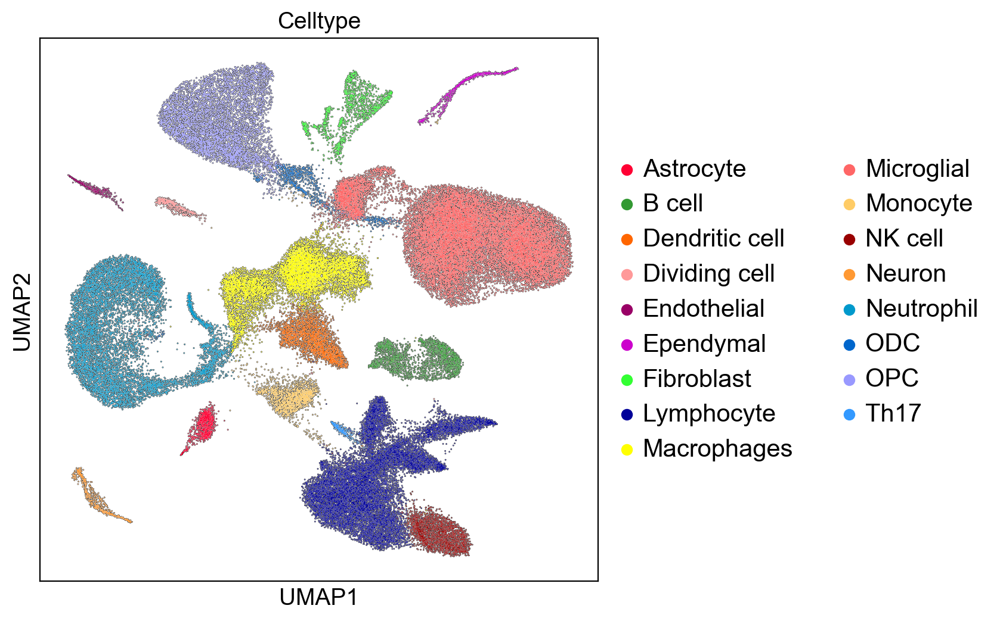

In [360]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(6,6))
sc.pl.umap(adata, color='Celltype',add_outline=True, legend_loc='right margin',
               legend_fontsize=15, legend_fontoutline= 1,frameon= True)

In [361]:
adata.obs["Celltype"] = adata.obs.Celltype.cat.set_categories([
       'Microglial','Astrocyte', 'OPC','ODC',
       'Neuron','Ependymal','Fibroblast','Endothelial',
       'Dividing cell','Lymphocyte','NK cell','Th17',
       'B cell','Monocyte','Macrophages','Neutrophil',
       'Dendritic cell'])

In [362]:
adata.obs["Celltype"] = adata.obs["Celltype"].astype('category')
adata.obs["Celltype"].cat.categories

Index(['Microglial', 'Astrocyte', 'OPC', 'ODC', 'Neuron', 'Ependymal',
       'Fibroblast', 'Endothelial', 'Dividing cell', 'Lymphocyte', 'NK cell',
       'Th17', 'B cell', 'Monocyte', 'Macrophages', 'Neutrophil',
       'Dendritic cell'],
      dtype='object')

In [363]:
new_colors = np.empty(len(adata.obs["Celltype"].cat.categories), dtype=object) 
new_colors[[0]] = '#FF0033' # Microglial
new_colors[[1]] = '#339933' # Astrocyte
new_colors[[2]] = '#FF6600' # 'OPC'
new_colors[[3]] = '#FF9999' # Oligodendrocyte
new_colors[[4]] = '#990066' # Neuron
new_colors[[5]] = '#CC00CC' #Ependymal
new_colors[[6]] = '#33FF33' # Fibroblast
new_colors[[7]] = '#000099' # Endothelial
new_colors[[8]] = '#FFFF00' # Dividing cell
new_colors[[9]] = '#FF6666' # Lymphocyte
new_colors[[10]] ='#FFCC66' # NK cell
new_colors[[11]] ='#990000' # Th17
new_colors[[12]] ='#FF9933' # B cell
new_colors[[13]] ='#0099CC' # Monocyte
new_colors[[14]] ='#0066CC' # Macrophages
new_colors[[15]] ='#9999FF' # Neutrophil
new_colors[[16]] ='#3399FF' # Dendritic cell
adata.uns["Celltype_colors"] = new_colors
new_colors

array(['#FF0033', '#339933', '#FF6600', '#FF9999', '#990066', '#CC00CC',
       '#33FF33', '#000099', '#FFFF00', '#FF6666', '#FFCC66', '#990000',
       '#FF9933', '#0099CC', '#0066CC', '#9999FF', '#3399FF'],
      dtype=object)

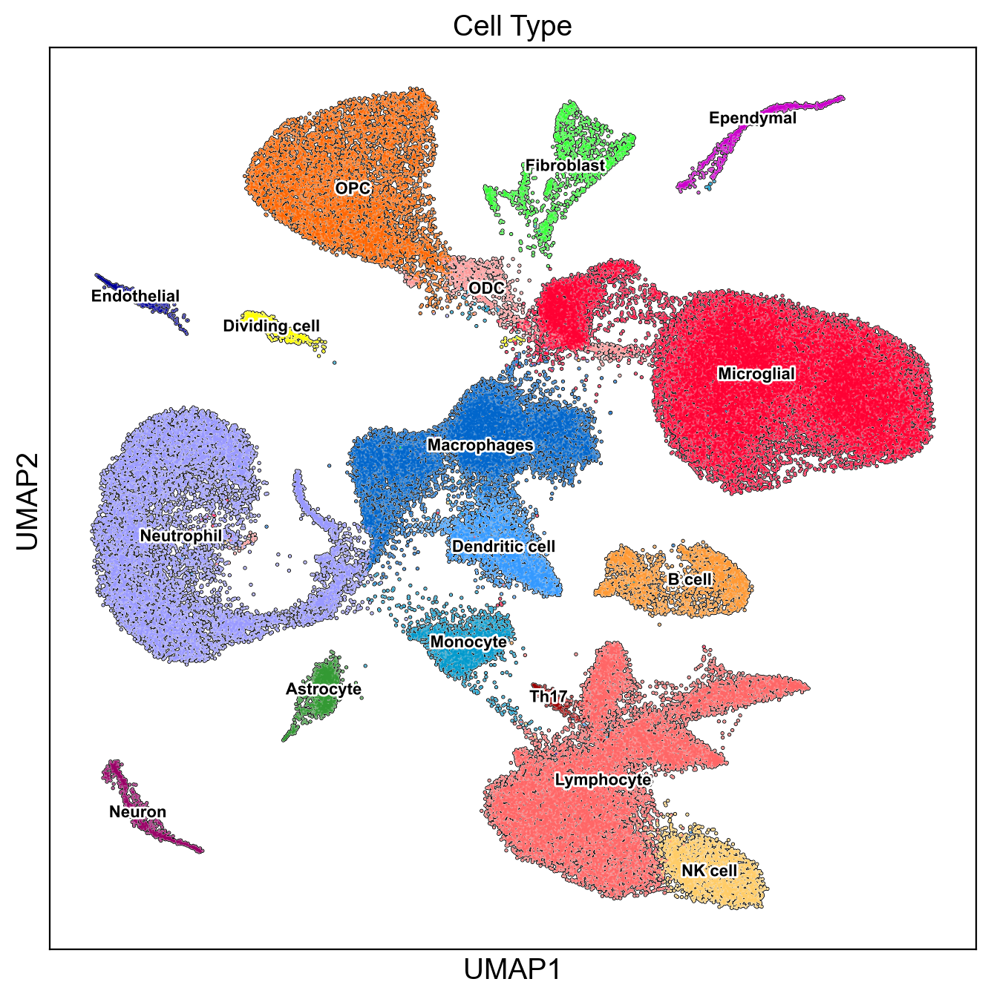

In [364]:
sc.settings.figdir = './result/'
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(8,8))
sc.pl.umap(adata, color='Celltype',legend_loc='on data',size=5,
           legend_fontsize=8, legend_fontoutline= 2,title='Cell Type',add_outline=True,
              frameon= True,save='celltype.pdf')


In [365]:
%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [366]:
%%R 
library(future)
library(RColorBrewer)
library(viridis)
library(Seurat)
library(harmony)
library(tidyverse)
library(patchwork)
library(ggplot2)
library(cowplot)
library(dplyr)
library(data.table)

In [367]:
adata

AnnData object with n_obs × n_vars = 88076 × 25375
    obs: 'ID', 'Type', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'n_counts', 'log_counts', 'doublet_scores', 'predicted_doublets', 'doublet_info', 'cluster_0.1', 'cluster_0.2', 'cluster_0.3', 'cluster_0.4', 'cluster_0.5', 'cluster_0.6', 'cluster_0.7', 'cluster_0.8', 'cluster_0.9', 'cluster_1.0', 'cluster_1.1', 'cluster_1.2', 'cluster_1.3', 'cluster_1.4', 'cluster_1.5', 'Cell type', 'Celltype'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Type_colors', 'doublet_info_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'tsne', 'leiden', 'cluster_0.2_colors', 'cluster_0.3_colors', 'cluster_0.4_colors', 'rank_genes_groups', 'cluste

In [368]:
adata.obs["Type"] = adata.obs.Type.cat.set_categories([
       'Control','Vehicle', 'Drug', 'Taxol'])

In [369]:
adata.obs["Type"] = adata.obs["Type"].astype('category')
adata.obs["Type"].cat.categories

Index(['Control', 'Vehicle', 'Drug', 'Taxol'], dtype='object')

In [370]:
Sample = adata.obs['Type']
cell_type = adata.obs['Celltype']
A = adata.obs

In [372]:
%%R -i A  -o rt
rt <- A
match_celltype_levels <- c('Microglial', 'Astrocyte', 'OPC', 'ODC', 'Neuron',
       'Ependymal', 'Fibroblast', 'Endothelial', 'Dividing cell', 'Lymphocyte',
       'NK cell', 'Th17', 'B cell', 'Monocyte', 'Macrophages', 'Neutrophil',
       'Dendritic cell')
allcolour <- c('#FF0033', '#339933', '#FF6600', '#FF9999', '#990066', '#CC00CC',
       '#33FF33', '#000099', '#FFFF00', '#FF6666', '#FFCC66', '#990000',
       '#FF9933', '#0099CC', '#0066CC', '#9999FF', '#3399FF')
a <- rt
length(colnames(a))
colnames(a)[34] = c('cell.type')
a[1:10,]
mydata <- a%>%
  group_by(Type) %>%
  mutate(celltype = factor(cell.type,levels = match_celltype_levels)) %>%
  arrange(celltype)
p1 = ggplot() +
  geom_bar(data = mydata, aes(x = Type, fill = factor(celltype)), position = position_fill(reverse = TRUE)) +scale_fill_manual(values = allcolour) +
  labs(fill = "cell type",x ='Group', y = "Fraction of cells")+theme(
      panel.grid.major = element_blank(), #主网格线
      panel.grid.minor = element_blank(),
      panel.background = element_rect(fill = 'white'), #背景色
      panel.border = element_rect(fill=NA,color="black", size=0.5, linetype="solid")
        )
p1 
ggsave('./result/Ratios_barplot.pdf',p1,width = 8,height = 12,dpi = 1000)

In [373]:
cluster = {
    'Microglial cell':["Apoe",'Ctss'],
    "Astrocyte":["Aqp4","Gfap"],
    "OPC":["Olig2"],
    "ODC":["Plp1"],
    'Neuron':["Map2","Dcx"],
    'Ependymal':["Tmem212","Foxj1"],
    'Fibroblast':["Dcn","Lum"],
    'Vascular endothelial cell':["Pecam1"],
    'Macrophage':["Ms4a7","Cd74"],
    'Lymphocyte':["Cd3d"],
    'Endothelial':["Cldn5","Pecam1"],
    'Dividing cell':["Cdk1","Mki67"],
    'Lymphocyte':["Cd3d"],
    'NK cell':["Nkg7"],
    'Th17':["Rora"],
    'B cell':["Cd79a","Cd79b"],
    'Monocyte':["Ly6c2","Csf1r"],
    'Macrophages':[ "Lyz2","Cd68"],
    'Neutrophils':["S100a8","S100a9"],
    'Dendritic cell':['Ccr7',"Cd74"]  
}
marker_list = []

for k,v in cluster.items():
    if isinstance(v,list):
        marker_list.extend(v)
    else:
        marker_list.append(v)

    using 'X_pca' with n_pcs = 30
Storing dendrogram info using `.uns['dendrogram_Celltype']`
categories: Microglial, Astrocyte, OPC, etc.
var_group_labels: Microglial cell, Astrocyte, OPC, etc.


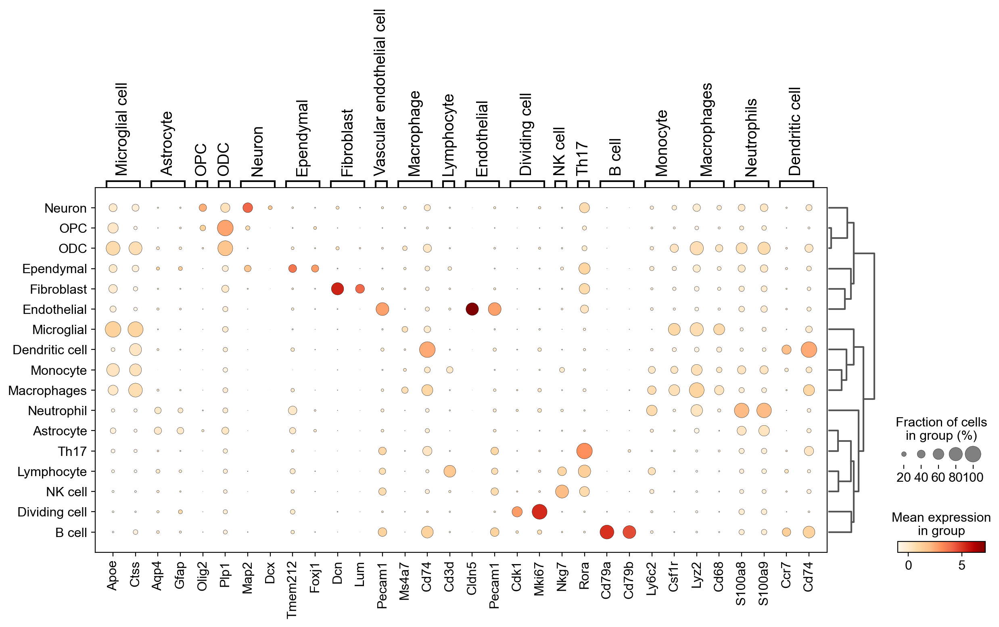

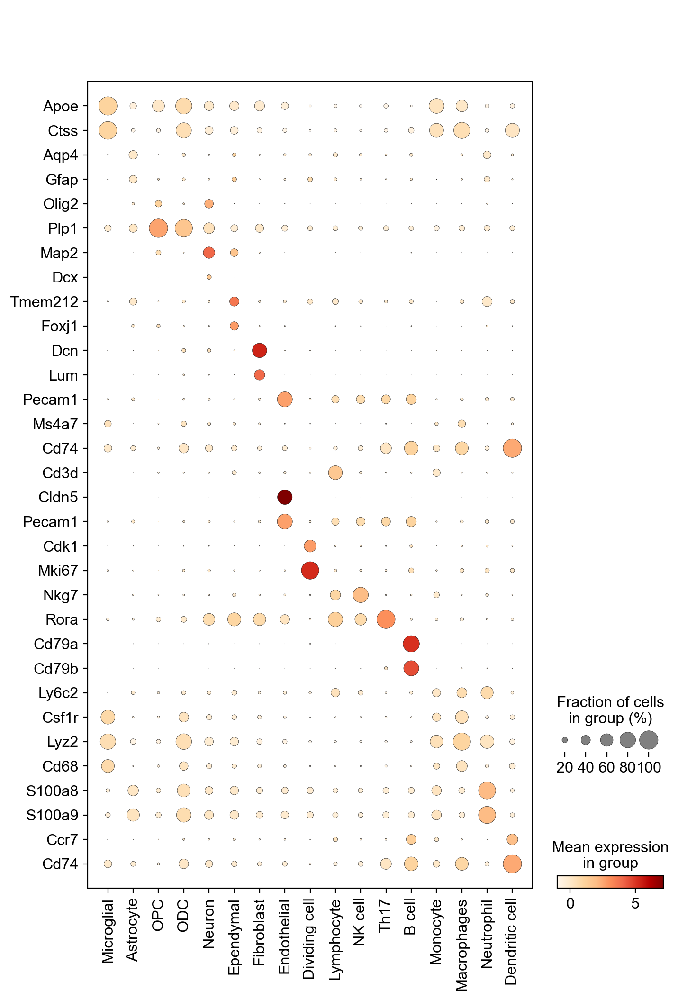

In [374]:
sc.pl.dotplot(adata, cluster, 'Celltype', dendrogram=True,cmap='OrRd',save= 'DOTmarker1.pdf')
sc.pl.dotplot(adata,marker_list, 'Celltype',cmap='OrRd',swap_axes=True,save= 'DOTmarker2.pdf')

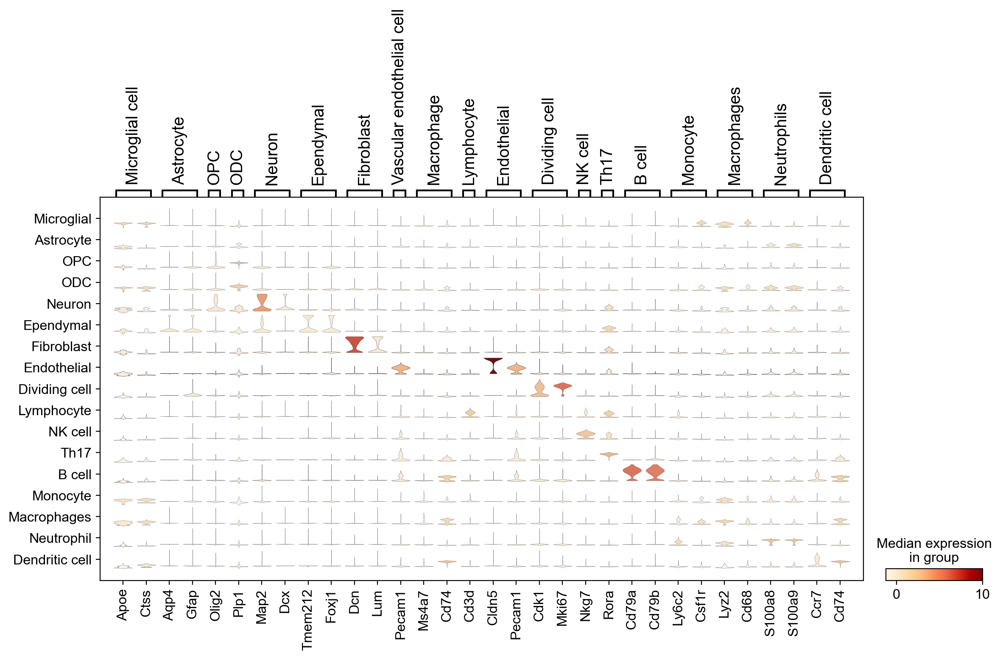

In [375]:
sc.pl.stacked_violin(adata, cluster, 'Celltype', cmap='OrRd',swap_axes=False,save='marker.pdf')

In [386]:
import gc
gc.collect()

145687

In [387]:
adata.write('./01.single data/scRNA_celltype.h5ad')

MemoryError: In RendererAgg: Out of memory

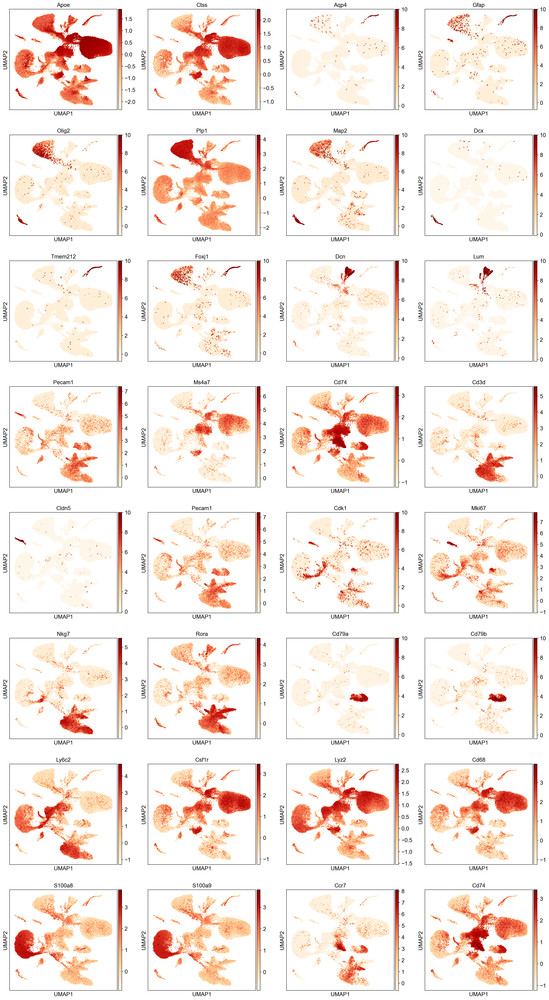

In [382]:
sc.settings.figdir = './result/'
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(5,5))
sc.pl.umap(adata,color=marker_list,ncols=4,cmap='OrRd',size=15,legend_fontsize=12,save='allmarker.pdf')